<h1><center> SAM inference on our dataset: Preliminary experiments

In [2]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np
import rasterio
import os

In [3]:
checkpoint_path = 'checkpoint/sam_vit_h_4b8939.pth'
sat_dir = 'part1/9/'
path = 'sentinel12_s1_9_img.tif'

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [5]:
# load sam
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

model_type = "vit_h"

sam = sam_model_registry[model_type](checkpoint=checkpoint_path)
sam.to(device=device)

mask_generator = SamAutomaticMaskGenerator(sam)

In [5]:
print(os.path.exists(os.path.join(sat_dir, path)))

True


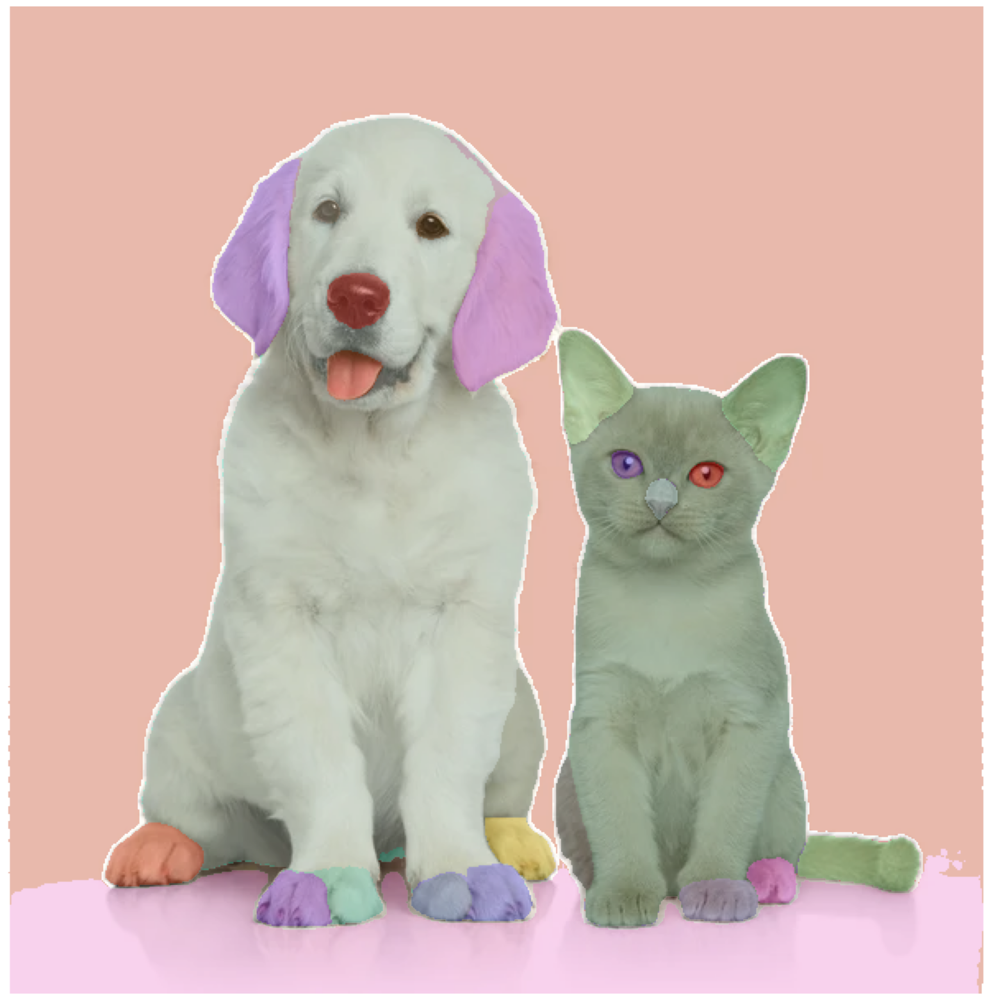

In [15]:
### TEST on dog cat 

# image = cv2.imread('depositphotos_51536413-stock-photo-dog-and-cat-together.jpeg')
# image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
# masks = mask_generator.generate(image)
# plt.figure(figsize=(20,20))
# plt.imshow(image)
# show_anns(masks)
# plt.axis('off')
# plt.show() 

# Preprocess SAR data

In [10]:

from rasterio.plot import show
def readGTIFF(fname):
    """
    Reads an image file into a numpy array,
    returns the numpy array with dimensios (height, width, channels)
    The returned numpy array is always of type numpy.float
    """
    # read the image into a np.array
    with  rasterio.open(fname, 'r') as s:
        # print('reading image of size: %s'%str(im.shape))
        im = s.read()
    return im.transpose([1,2,0]) #.astype(float)


In [11]:
def read_rasterio(fp):
    img = rasterio.open(fp)
    return img

In [ ]:
#imagesar=readGTIFF(sat_dir+path)
imagesar=read_rasterio(sat_dir+path)
imagesar = imagesar.read()
sar_channel = np.moveaxis(imagesar, 0, -1)
sar_channel = cv2.resize(sar_channel, (1024, 1024))

In [35]:
sar_channel.shape

(1024, 1024, 2)

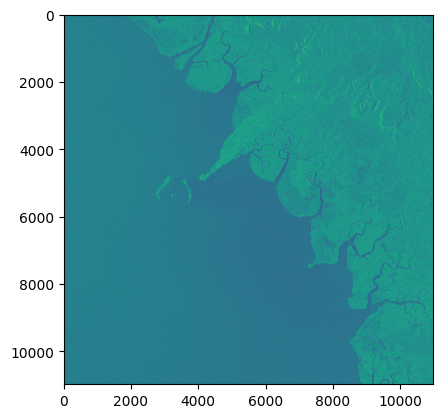

<Axes: >

In [54]:
show(imagesar[:,:,0]) #VV

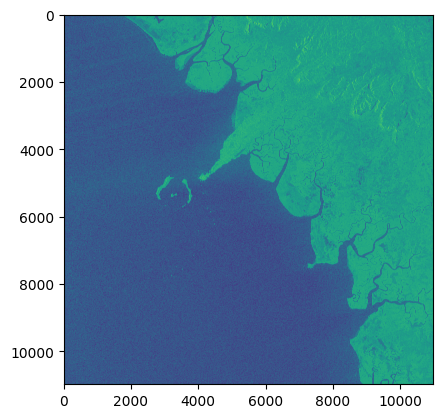

<Axes: >

In [22]:
show(imagesar[:,:,1]) # VH

In [8]:
# plot img
min_val = sar_channel.min()
max_val = sar_channel.max()

# Mettre à l'échelle l'image
scaled_image = (sar_channel - min_val) / (max_val - min_val)  # normaliser entre 0 et 1
scaled_image = (scaled_image * 255).astype(np.uint8)

sar_channel = scaled_image

In [9]:
rgb_plot = sar_channel

In [10]:
sar_channel = sar_channel.astype(np.float32)

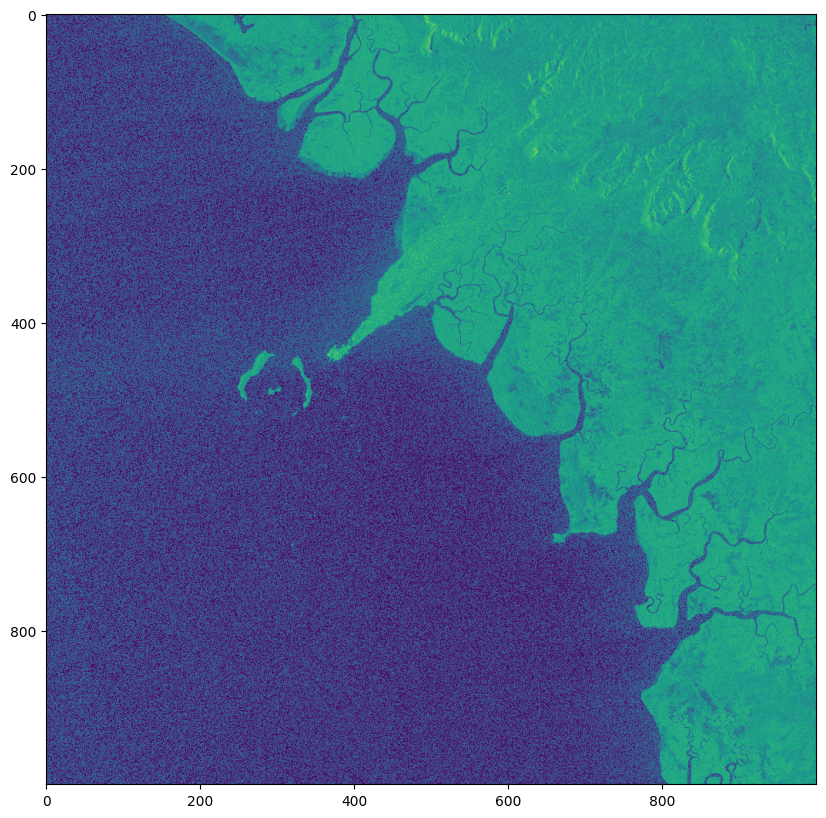

In [65]:
plt.figure(figsize=(10,10))
plt.imshow(rgb_plot[:,:,1])
plt.axis('on')
plt.show()

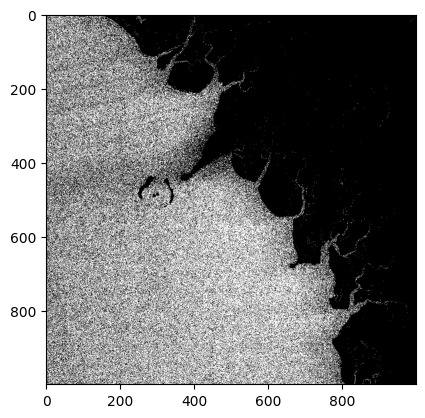

In [68]:
naive_mask = sar_channel[:,:,1] < 55
plt.imshow(naive_mask, cmap='gray')

## Band processing

### Difference as third channel

In [12]:
imagesar=read_rasterio(sat_dir+path)
imagesar = imagesar.read()
sar_channel = np.moveaxis(imagesar, 0, -1)

In [13]:
def standardize_minmax(array):
    stand = (array - array.min()) / (array.max() - array.min())
    return (stand * 255).astype(np.uint8)

In [14]:
vv = standardize_minmax(sar_channel[:,:,0])
vh = standardize_minmax(sar_channel[:,:,1])
diff = vv - vh # This difference highlights areas where the dominant scattering mechanism changes between surface and volume scattering
# eps = 1e-8
# vv_eps = np.copy(vv)
# vv_eps[vv_eps==0.0] = 1
# pr = vh/vv_eps # polarimetric ratio, This ratio is sensitive to surface roughness and can be used to differentiate between different surface types

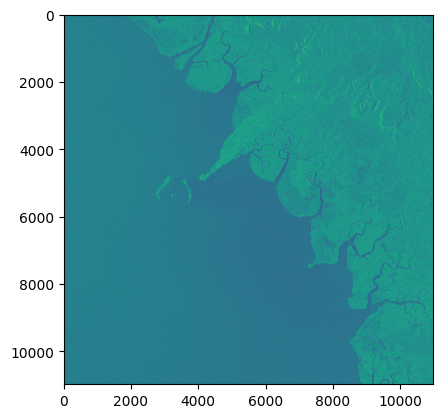

<Axes: >

In [23]:
show(vv)

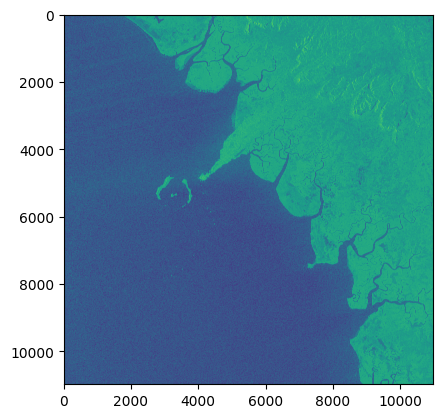

<Axes: >

In [28]:
show(vh)

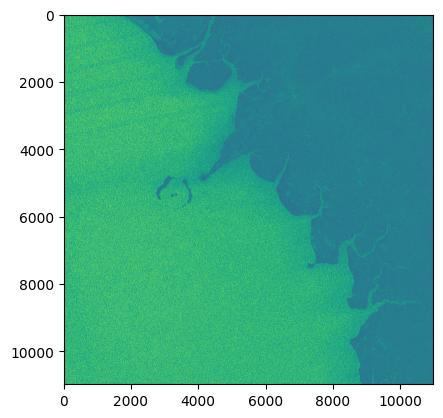

<Axes: >

In [11]:
show(diff)

In [15]:
img_3d = np.stack([vv,vh,diff], axis=-1) 
#img_3d = cv2.resize(img_3d, (1000,1000)) # resize 
img_3d.shape


(10980, 10980, 3)

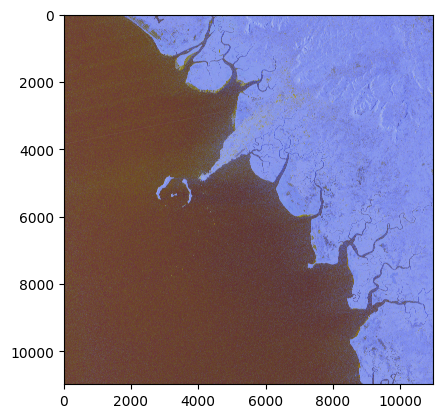

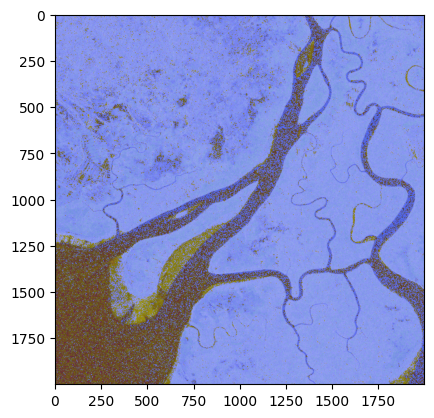

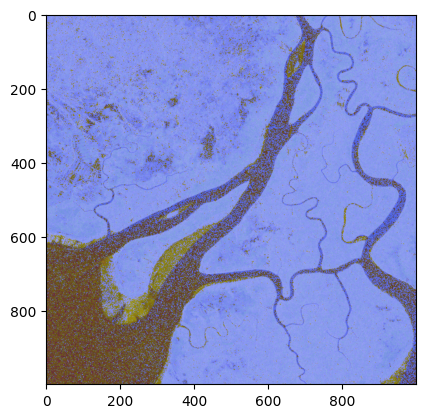

In [16]:
crop = img_3d[0:2000,3000:5000,:]
crop_resize = cv2.resize(crop,(1000,1000))

plt.imshow(img_3d)
plt.figure()
plt.imshow(crop)
plt.figure()
plt.imshow(crop_resize)

### Composite RBG: https://sentinels.copernicus.eu/web/sentinel/user-guides/sentinel-1-sar/product-overview/polarimetry
The composite RGB (colour) image on the right was created using the VV channel for red, VH channel for green and the ratio |VV| / |VH| for blue.

In [86]:
red = sar_channel[:,:,0] #.astype(np.float32) # vv
green = sar_channel[:,:,1] #.astype(np.float32) # vh

# blue color
#green_eps = np.copy(green).astype(np.float32)
#green_eps[green_eps == 0] = green.min()
blue = np.abs(red.astype(np.float32)) / np.abs(green.astype(np.float32)) # ratio

max_no_inf = np.max(blue[blue < blue.max()])
blue_corr = np.nan_to_num(blue, nan=0, posinf=max_no_inf)

# blue_scale = standardize_minmax(blue)
# img_rgb = np.stack([standardize_minmax(red),standardize_minmax(green),blue_scale], axis=-1) # fake colors 

/var/folders/hd/6gcp429169ldrntwtps0b1_m0000gp/T/ipykernel_65363/2693569411.py:7: RuntimeWarning: divide by zero encountered in divide
  blue = np.abs(red.astype(np.float32)) / np.abs(green.astype(np.float32)) # ratio
/var/folders/hd/6gcp429169ldrntwtps0b1_m0000gp/T/ipykernel_65363/2693569411.py:7: RuntimeWarning: invalid value encountered in divide
  blue = np.abs(red.astype(np.float32)) / np.abs(green.astype(np.float32)) # ratio


ValueError: zero-size array to reduction operation maximum which has no identity

In [88]:
blue[blue < blue.max()-1]

array([], dtype=float32)

In [63]:
blue_bis = np.copy(blue)
second_max 
blue_bis[blue_bis==blue.max()] = 

17031

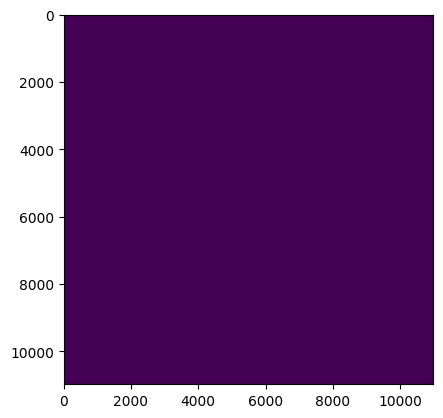

In [71]:
plt.imshow(blue)

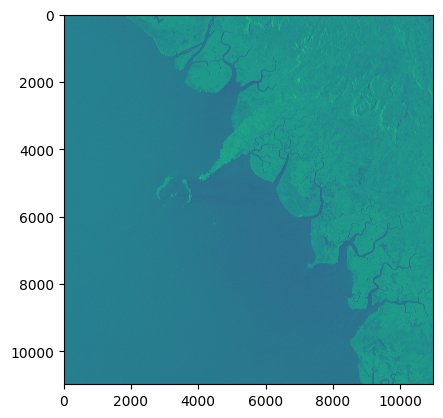

In [51]:
plt.imshow(img_rgb[:,:,0]) # red

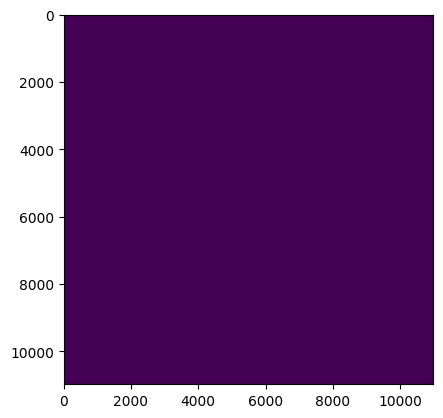

In [58]:
plt.imshow(img_rgb[:,:,2])

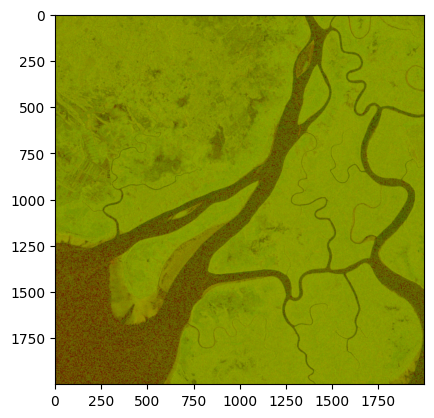

In [54]:
plt.imshow(img_rgb[:2000,3000:5000,:])

# Mask generator

In [43]:
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

### Difference

In [44]:
masks = mask_generator.generate(crop_resize)

In [45]:
print(len(masks))
print(masks[0])

20
{'segmentation': array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]]), 'area': 79400, 'bbox': [312, 713, 502, 286], 'predicted_iou': 0.9885369539260864, 'point_coords': [[453.125, 859.375]], 'stability_score': 0.9654683470726013, 'crop_box': [0, 0, 1000, 1000]}


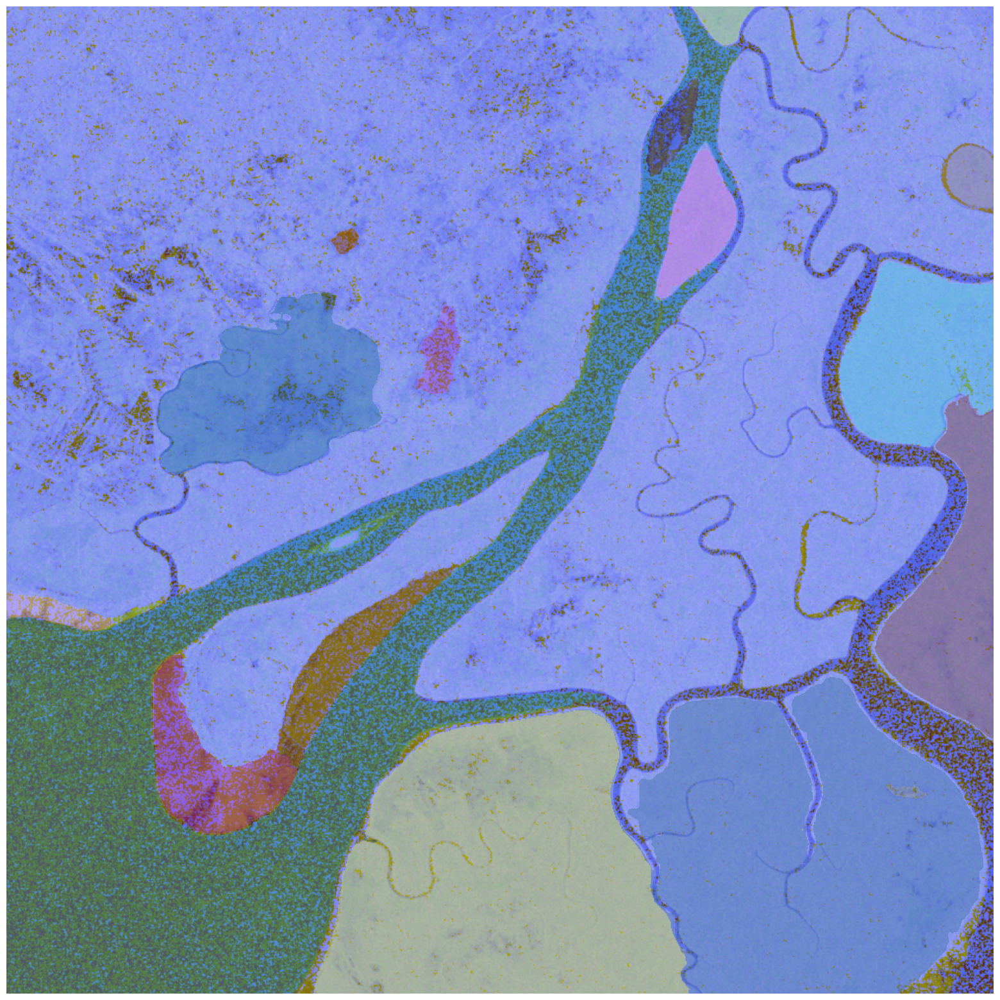

In [46]:
plt.figure(figsize=(20,20))
plt.imshow(crop_resize)
show_anns(masks)
plt.axis('off')
plt.show() 

# Preprocessing: morphology 
This is done on only one channel of the image, either VV, VH or the difference.

## Thresholds

skimage.filters.thresholding.threshold_isodata
skimage.filters.thresholding.threshold_li
skimage.filters.thresholding.threshold_mean
skimage.filters.thresholding.threshold_minimum
skimage.filters.thresholding.threshold_otsu
skimage.filters.thresholding.threshold_triangle
skimage.filters.thresholding.threshold_yen


(<Figure size 800x500 with 8 Axes>,
 array([<Axes: title={'center': 'Original'}>,
        <Axes: title={'center': 'Isodata'}>,
        <Axes: title={'center': 'Li'}>, <Axes: title={'center': 'Mean'}>,
        <Axes: title={'center': 'Minimum'}>,
        <Axes: title={'center': 'Otsu'}>,
        <Axes: title={'center': 'Triangle'}>,
        <Axes: title={'center': 'Yen'}>], dtype=object))

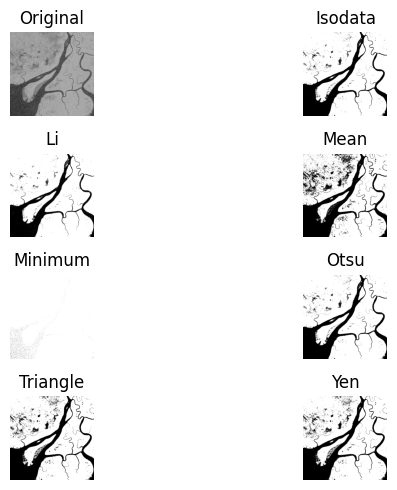

In [17]:
from skimage.filters import try_all_threshold, threshold_li, frangi, median, threshold_multiotsu
try_all_threshold(crop_resize[:,:,1])

Text(0.5, 1.0, 'Frangi')

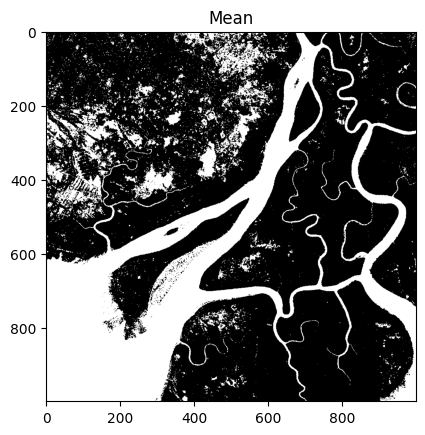

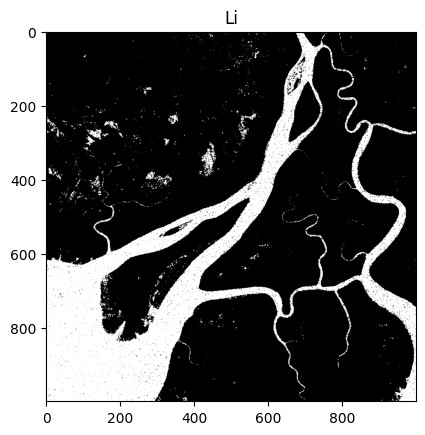

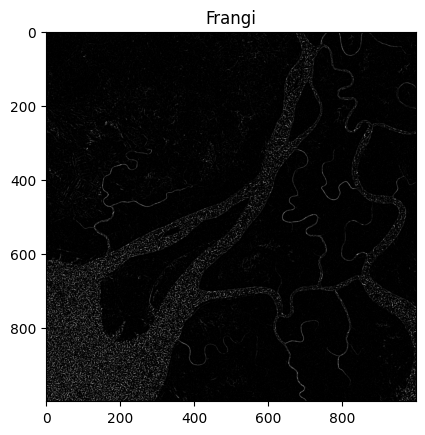

In [167]:
vh_crop = crop_resize[:,:,1]
mean_mask = vh_crop < np.mean(vh_crop)
li_mask = vh_crop < threshold_li(vh_crop)
frangi_mask = frangi(vh_crop,sigmas=range(1,5,2))
#multi_mask = vh_crop < threshold_multiotsu(vh_crop, classes=3)
plt.imshow(mean_mask,cmap='gray')
plt.title('Mean')
plt.figure()
plt.imshow(li_mask, cmap='gray')
plt.title("Li")
plt.figure()
plt.imshow(frangi_mask,cmap='gray')
plt.title('Frangi')



/Users/mayajanvier/anaconda3/envs/env_dents/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3553: UserWarning: Possible precision loss converting image of type float64 to uint8 as required by rank filters. Convert manually using skimage.util.img_as_ubyte to silence this warning.
  exec(code_obj, self.user_global_ns, self.user_ns)


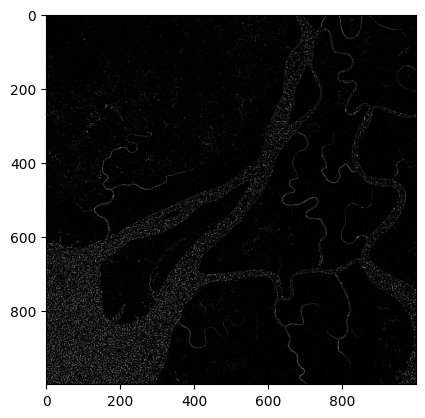

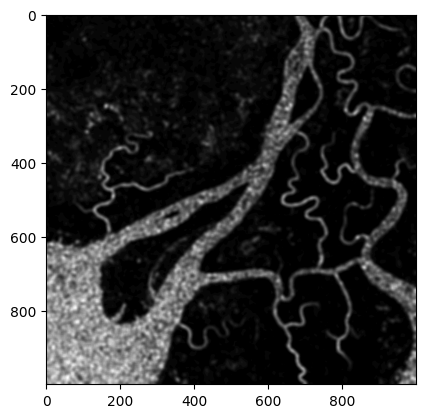

In [168]:
from skimage.filters.rank import mean
from skimage.morphology import disk
loc_mean = mean(frangi_mask, disk(5))
loc_mean = mean(loc_mean, disk(5))
plt.imshow(frangi_mask, cmap='gray')
plt.figure()
plt.imshow(loc_mean,cmap='gray')

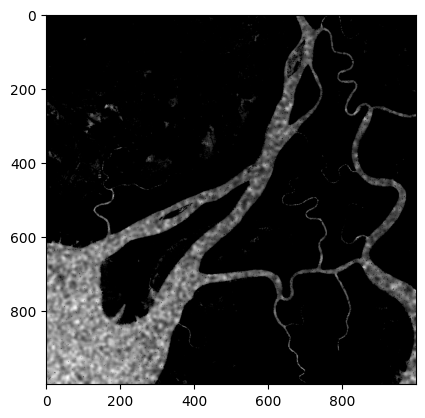

In [172]:
plt.imshow(loc_mean*li_mask,cmap='gray')

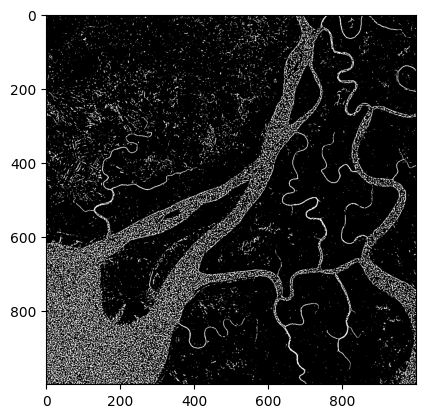

In [169]:
frangi_threshold = frangi_mask > threshold_li(frangi_mask)
plt.imshow(frangi_threshold, cmap='gray')

### All image

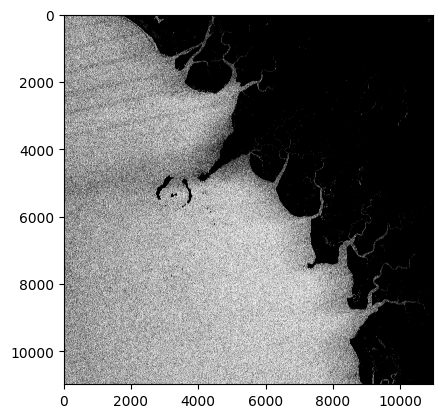

In [18]:
vh = img_3d[:,:,1]
li_mask = vh < threshold_li(vh)
plt.imshow(li_mask,cmap='gray')

## Sample points for prompt using SAM predictor
Idea Li: grid on mask image, get dominant color class, get random point from dominant class, assign label

Cases de taille 10,10

In [229]:
import numpy as np

def get_prompt_points(mask):
    step = len(mask) // 10
    prompt_points = []
    labels = []
    
    for i in range(0, mask.shape[0], step):
        for j in range(0, mask.shape[1], step):
            submask = mask[i:i+step, j:j+step]
            land_count = np.count_nonzero(submask == False)
            water_count = np.count_nonzero(submask == True)
            #print(land_count, water_count)
            
            if land_count > water_count:
                dom_label = 0  # Land is the dominant class
            else:
                dom_label = 1  # Water is the dominant class
            #print(dom_label)
                
            # Get the indices of all pixels belonging to the dominant class
            dominant_class_pixels_indices = np.where(submask == dom_label)[0]
            # Randomly select one pixel index from the dominant class
            random_pixel_index = np.random.choice(dominant_class_pixels_indices)
            # Convert pixel index to coordinates
            random_pixel_coordinates = np.unravel_index(random_pixel_index, submask.shape)
            # Add the random pixel coordinates to the prompt points list
            prompt_points.append([j + random_pixel_coordinates[1], i + random_pixel_coordinates[0]])
            labels.append(dom_label)

    
    return np.array(prompt_points),np.array(labels)

prompts,labels = get_prompt_points(li_mask)


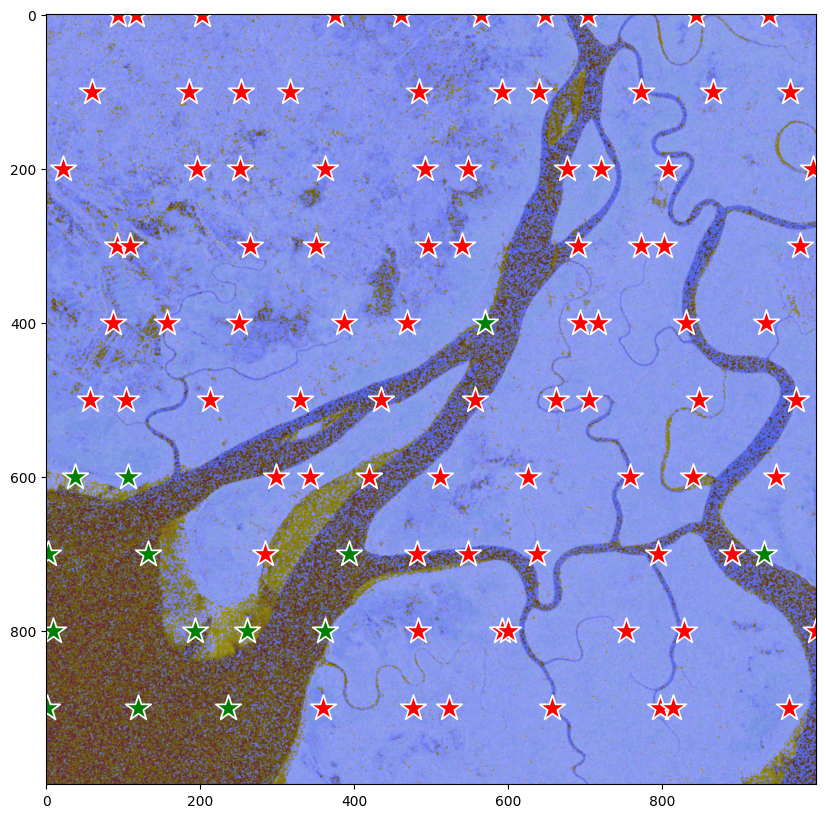

In [231]:
plt.figure(figsize=(10,10))
plt.imshow(crop_resize)
show_points(prompts, labels, plt.gca())
plt.axis('on')
plt.show() 

In [218]:
predictor.set_image(crop_resize)

In [219]:
masks, scores, logits = predictor.predict(
    point_coords=prompts,
    point_labels=labels,
    multimask_output=True,
)

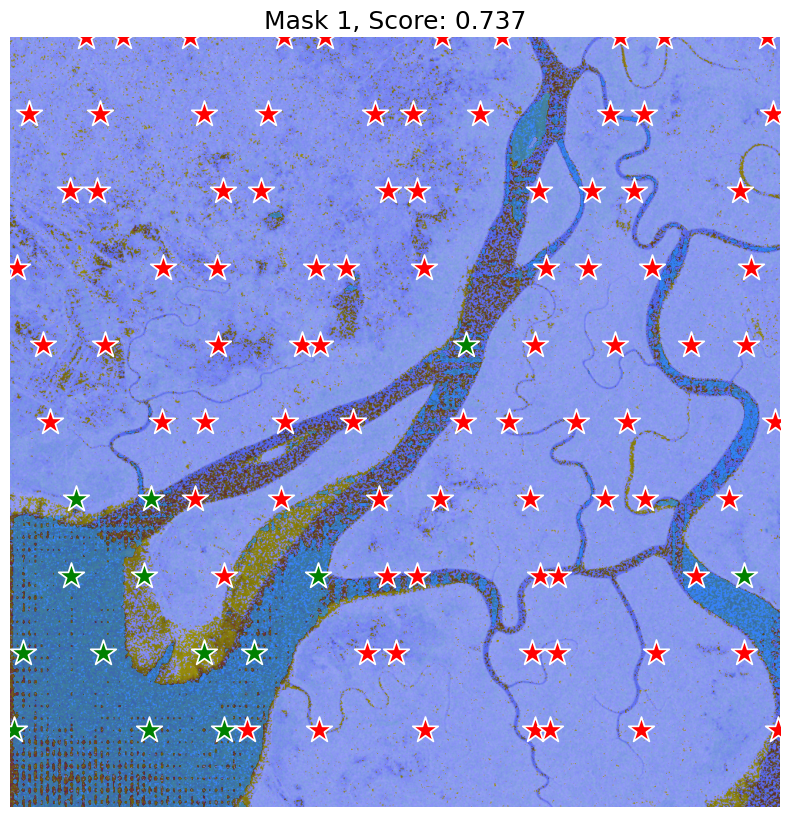

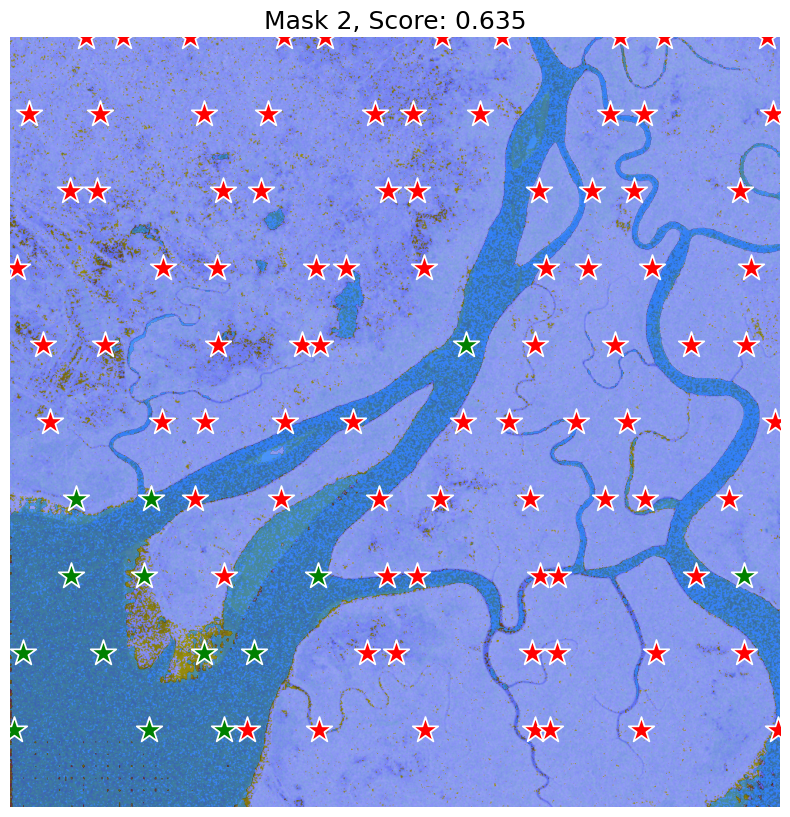

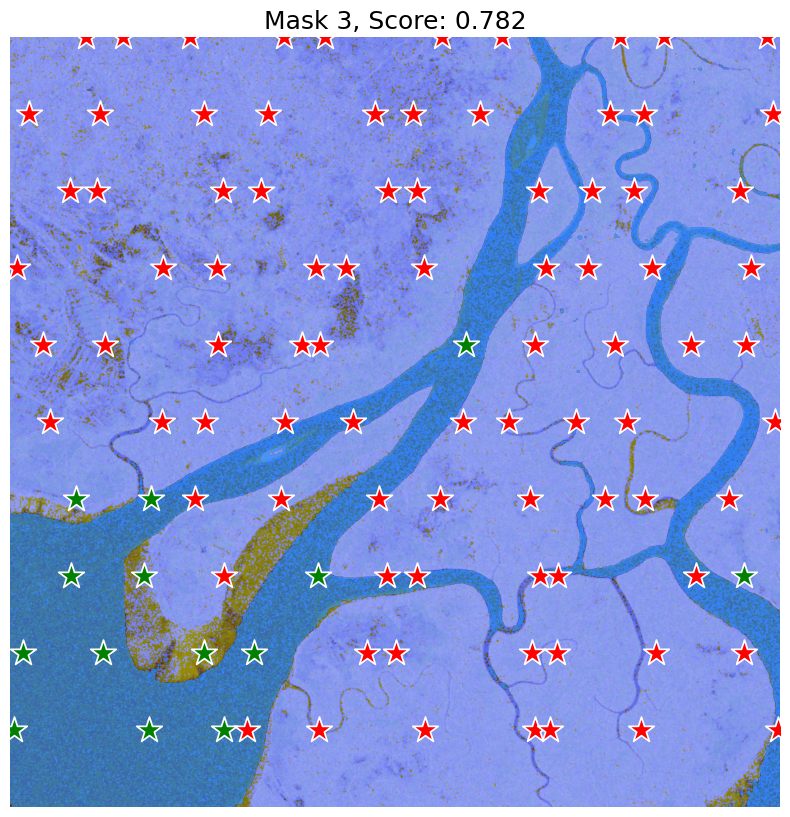

In [220]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(crop_resize)
    show_mask(mask, plt.gca())
    show_points(prompts, labels, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  
  

In [233]:
def get_near_center_points(mask):
    step = len(mask) // 10 
    near_center_points = []
    labels = []
    
    for i in range(0, mask.shape[0], step):
        for j in range(0, mask.shape[1], step):
            submask = mask[i:i+step, j:j+step]
            land_count = np.count_nonzero(submask == False)
            water_count = np.count_nonzero(submask == True)
            
            if land_count > water_count:
                dom_label = 0  # Land is the dominant class
            else:
                dom_label = 1  # Water is the dominant class
                
            # Calculate the center coordinates of the submask
            #center_row = i + step // 2
            #center_col = j + step // 2
            
            # Search for the nearest dominant class pixel to the center coordinates
            dist_to_center = np.sum(np.abs(np.argwhere(submask == dom_label) - np.array([step // 2, step // 2])), axis=1)
            nearest_index = np.argmin(dist_to_center)
            nearest_coords = np.argwhere(submask == dom_label)[nearest_index]
            
            # Add the nearest coordinates to the near-center points list
            near_center_points.append([j + nearest_coords[1], i + nearest_coords[0]])  # Note the order: [col, row]
            labels.append(dom_label)
    
    return np.array(near_center_points), np.array(labels)

# Example usage:
near_center_points, labels = get_near_center_points(li_mask)
print("Near-Center Points:", near_center_points)
print("Labels:", labels)


Near-Center Points: [[ 50  50]
 [150  50]
 [250  50]
 [350  50]
 [450  50]
 [550  50]
 [650  50]
 [750  50]
 [850  50]
 [950  50]
 [ 50 150]
 [150 150]
 [250 150]
 [350 150]
 [450 150]
 [550 150]
 [652 149]
 [750 150]
 [850 150]
 [950 150]
 [ 50 250]
 [150 250]
 [250 250]
 [350 250]
 [450 250]
 [550 250]
 [654 248]
 [750 250]
 [850 249]
 [950 250]
 [ 50 350]
 [150 350]
 [250 350]
 [350 350]
 [450 350]
 [550 350]
 [650 350]
 [750 350]
 [850 350]
 [950 350]
 [ 50 450]
 [150 450]
 [250 450]
 [350 450]
 [450 450]
 [550 450]
 [650 450]
 [750 450]
 [850 450]
 [950 450]
 [ 50 550]
 [150 551]
 [250 550]
 [350 552]
 [450 550]
 [550 550]
 [650 550]
 [750 550]
 [850 550]
 [952 550]
 [ 50 650]
 [150 650]
 [250 650]
 [350 650]
 [450 650]
 [550 650]
 [650 650]
 [750 650]
 [850 650]
 [950 650]
 [ 50 750]
 [150 750]
 [250 750]
 [350 750]
 [450 750]
 [550 750]
 [650 750]
 [750 750]
 [850 750]
 [950 750]
 [ 50 850]
 [150 850]
 [250 850]
 [347 850]
 [450 850]
 [550 850]
 [650 850]
 [750 850]
 [850 850]
 

In [234]:
masks, scores, logits = predictor.predict(
    point_coords=near_center_points,
    point_labels=labels,
    multimask_output=True,
)

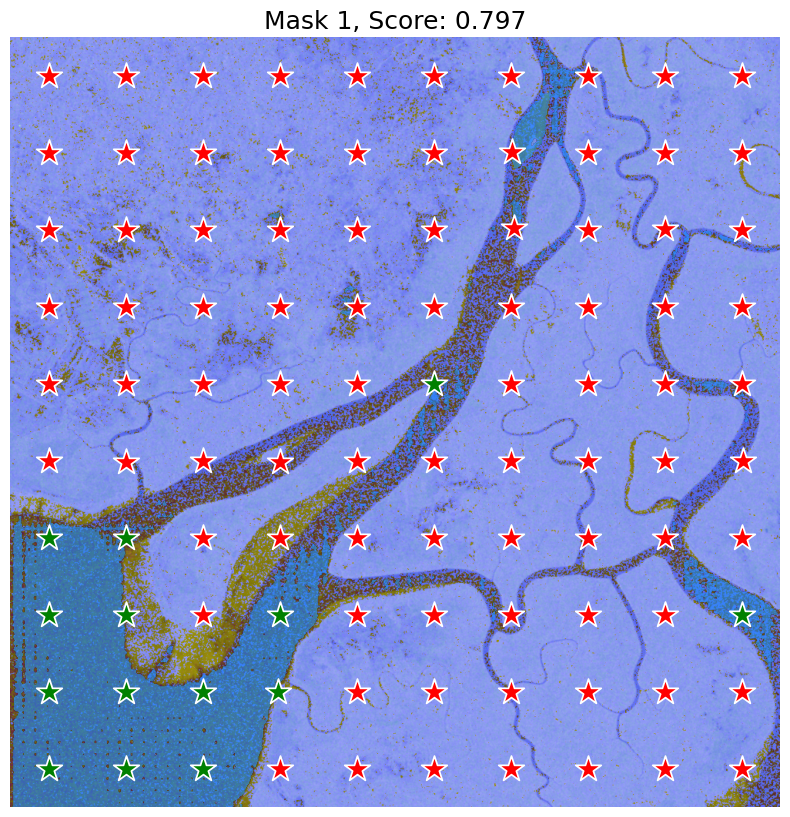

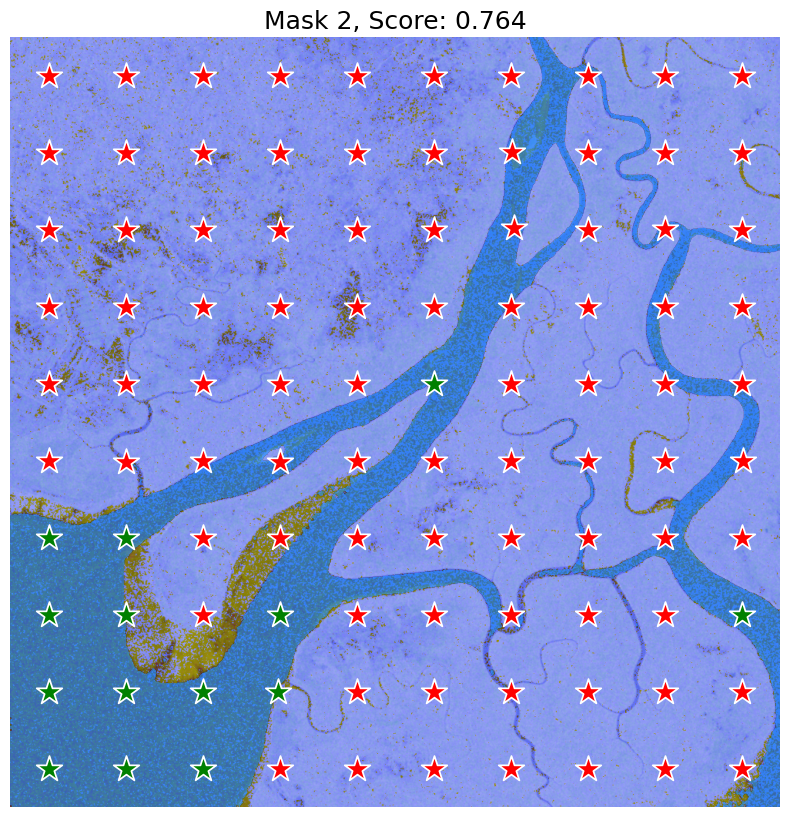

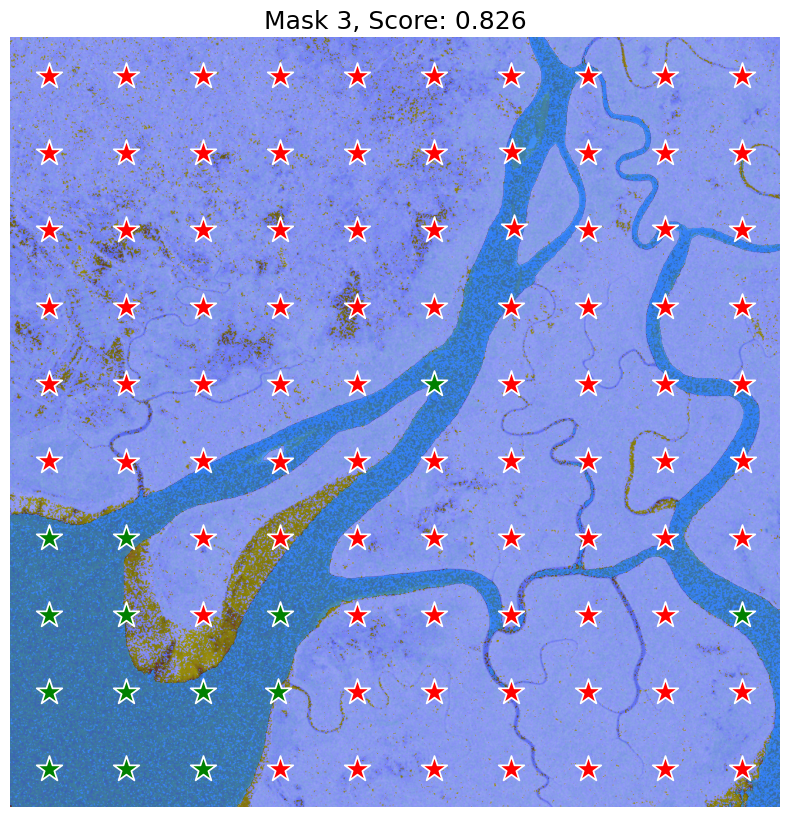

In [235]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(crop_resize)
    show_mask(mask, plt.gca())
    show_points(near_center_points, labels, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  
  

# Mask predictor

- donner un point et voir si ca marche 
- afficher toutes les channels S2
- donner des images plus petites 
- trouver un model de prompt
 filtre couleur + filtre 3MM
- change le catalogue 

Sentinel-1 image bands
{"VV": 0, "VH": 1}

Sentinel-2 image bands
{"Blue": 0, "Green": 1, "Red": 2, "NIR": 3, "SWIR1": 4, "SWIR2": 5}


In [89]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

In [90]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

In [91]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor


predictor = SamPredictor(sam)

In [92]:
predictor.set_image(crop_resize)

In [122]:
input_point = np.array([[100, 900],[900,700],[600,650]])
input_label = np.array([1,1,0])

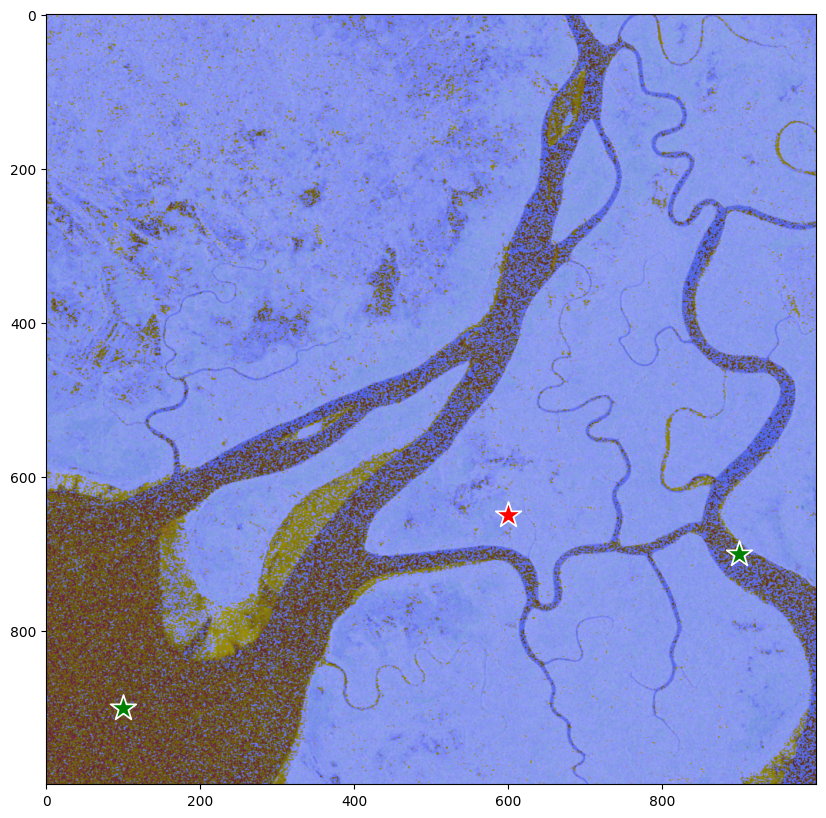

In [123]:
plt.figure(figsize=(10,10))
plt.imshow(crop_resize)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show() 

In [124]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

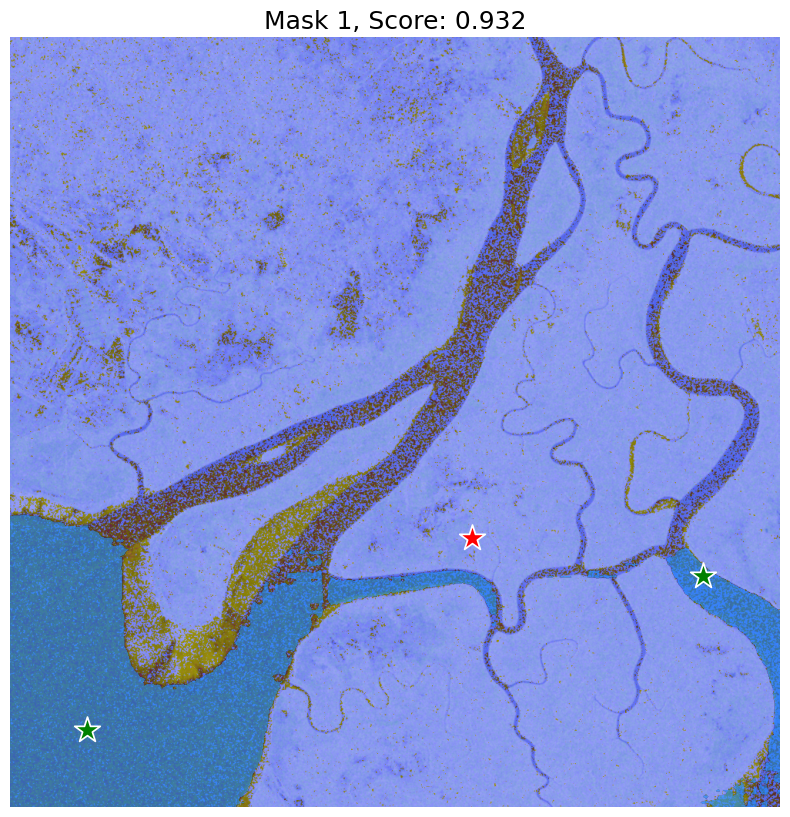

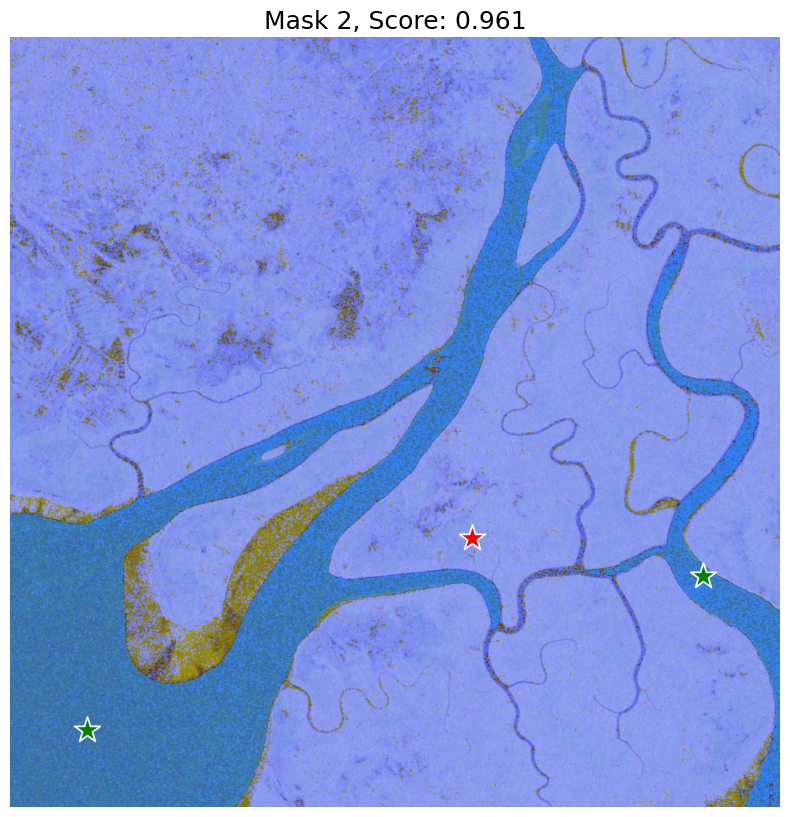

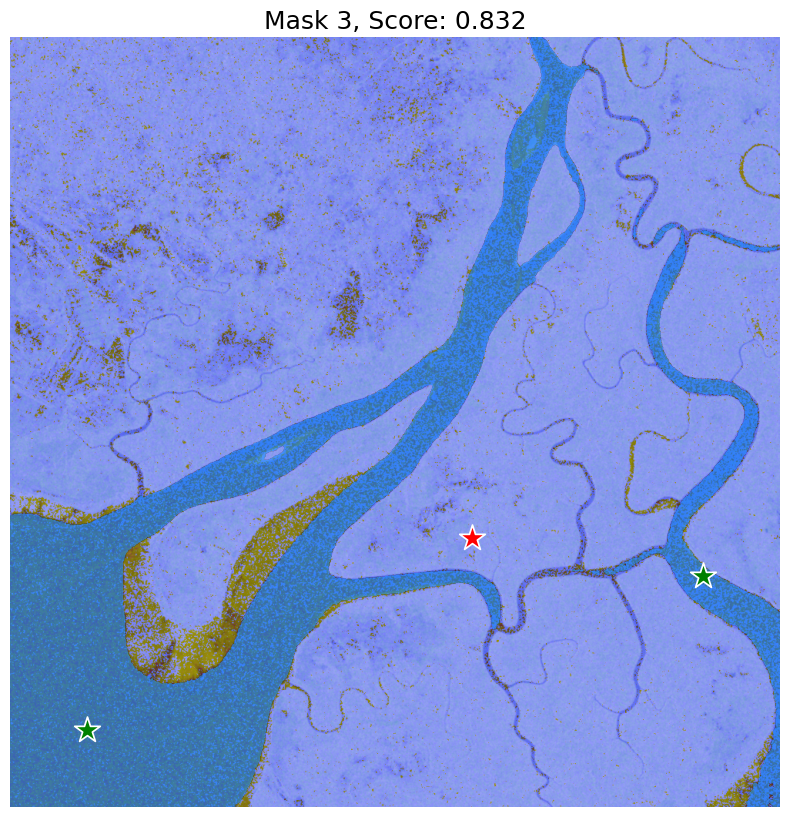

In [125]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(crop_resize)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  
  